## Download dataset

In [6]:
# prompt: download this "https://drive.google.com/file/d/1iWaDuDQKftRDZ_poWyEua7j6_leDhDQc/view?usp=sharing"

!gdown --id 1iWaDuDQKftRDZ_poWyEua7j6_leDhDQc


/usr/local/lib/python3.10/dist-packages/gdown/cli.py:138: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1iWaDuDQKftRDZ_poWyEua7j6_leDhDQc
To: /content/box_train.zip
100% 4.76M/4.76M [00:00<00:00, 170MB/s]


In [7]:
# prompt: # unzip "box_train.zip"

!unzip box_train.zip

Archive:  box_train.zip
  inflating: train/box_0.jpg         
  inflating: train/box_1.jpg         
  inflating: train/box_100.jpg       
  inflating: train/box_101.jpg       
  inflating: train/box_102.jpg       
  inflating: train/box_103.jpg       
  inflating: train/box_104.jpg       
  inflating: train/box_105.jpg       
  inflating: train/box_106.jpg       
  inflating: train/box_107.jpg       
  inflating: train/box_108.jpg       
  inflating: train/box_109.jpg       
  inflating: train/box_11.jpg        
  inflating: train/box_110.jpg       
  inflating: train/box_111.jpg       
  inflating: train/box_112.jpg       
  inflating: train/box_113.jpg       
  inflating: train/box_114.jpg       
  inflating: train/box_115.jpg       
  inflating: train/box_116.jpg       
  inflating: train/box_117.jpg       
  inflating: train/box_118.jpg       
  inflating: train/box_119.jpg       
  inflating: train/box_120.jpg       
  inflating: train/box_121.jpg       
  inflating: train/box_122

In [8]:
dataset_path = "/content/train"

____

In [3]:
import cv2 #import computer vision lib
import numpy as np #import numpy as np
import torch #import pytorch
import matplotlib.pyplot as plt
import os #importing operating system , this module provides a way to interact with operating system including accesssing env var and changing the working directory
HOME = os.getcwd()  #get the current work directory using the getcwd(), and assign it to home var
print("HOME:", HOME)
%cd {HOME}. #this line changes the current working directory to the value of the HOME


HOME: /content
[Errno 2] No such file or directory: '/content. #this line changes the current working directory to the value of the HOME'
/content


In [9]:
using_colab = True
if using_colab:
    import torch
    import torchvision
    print("PyTorch version:", torch.__version__)
    print("Torchvision version:", torchvision.__version__)
    print("CUDA is available:", torch.cuda.is_available())
    import sys
    !{sys.executable} -m pip install opencv-python matplotlib onnx onnxruntime
    !{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'

    !mkdir images
    !wget -P images https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/truck.jpg

    # Download pretrained model
    !wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

PyTorch version: 2.2.1+cu121
Torchvision version: 0.17.1+cu121
CUDA is available: True
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 79.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 104.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 13.9 MB/s eta 0:00:00
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-_8cchih2
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-_8cchih2
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36590 sha256=8d87cf33ba580c98ed5cf668fe150908892b7f0e7276b242d754bde02021534f
  Stored in directory: /t

___

## Setup

In [10]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2

In [11]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))


## Example image

## Using pretrained model

In [6]:
sam_checkpoint = "/content/sam_vit_h_4b8939.pth"
model_type = "vit_h"

In [12]:
# prompt: device = "cuda" or cpu

device = "cuda" if torch.cuda.is_available() else "cpu"

In [13]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

predictor = SamPredictor(sam)

## Example image

In [15]:
def list_image_files(directory):
    image_extensions = ['.jpg', '.jpeg', '.png', '.gif', '.bmp']  # Add more if needed
    image_files = []
    for root, dirs, files in os.walk(directory):
        for file in files:
            if any(file.lower().endswith(ext) for ext in image_extensions):
                image_files.append(os.path.join(root, file))
    return image_files

image_paths = list_image_files(dataset_path)

In [25]:
sample_img_path = image_paths[40]

In [26]:
image = cv2.imread(sample_img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

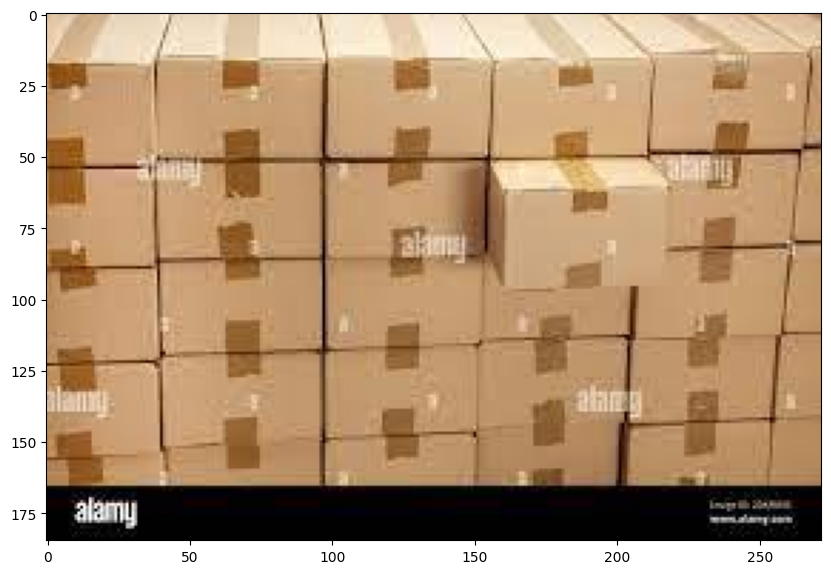

In [49]:
def plot_image(image):
  plt.figure(figsize=(10,10))
  plt.imshow(image)
  plt.axis('on')
  plt.show()

plot_image(image)

In [28]:
# prompt: get image resolution

image_height, image_width, _ = image.shape
print(f"Image resolution: {image_width}x{image_height}")


Image resolution: 272x185


In [29]:
center_point_coords = [ int(image_width/2), int(image_height/2)]

In [30]:
input_point = np.array([center_point_coords])
input_label = np.array([1])

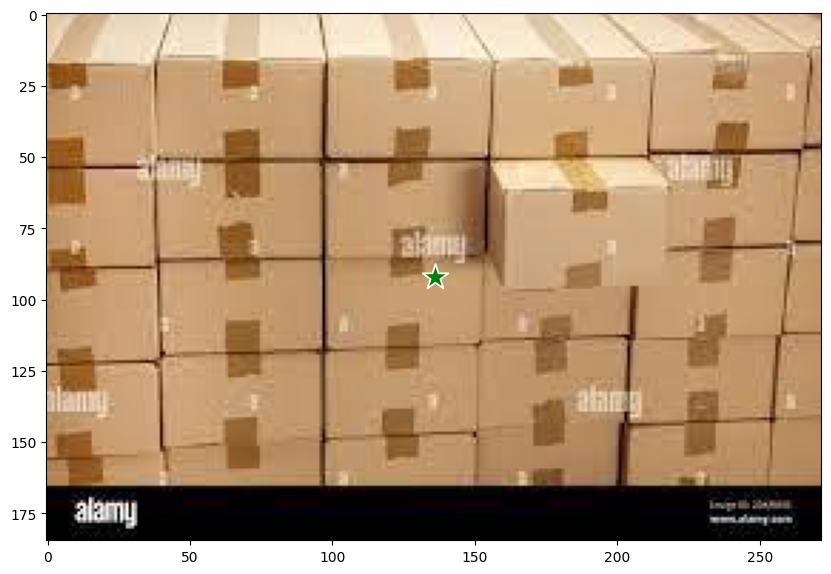

In [31]:
plt.figure(figsize=(10,10))
plt.imshow(image)
show_points(input_point, input_label, plt.gca())
plt.axis('on')
plt.show()

### Mask prediction

In [32]:
predictor.set_image(image)

In [33]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)

In [34]:
masks.shape  # (number_of_masks) x H x W

(3, 185, 272)

In [37]:
def plot_mask_with_score(image, title,mask, score, input_point, input_label ):
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    show_mask(mask, plt.gca())
    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {title}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()

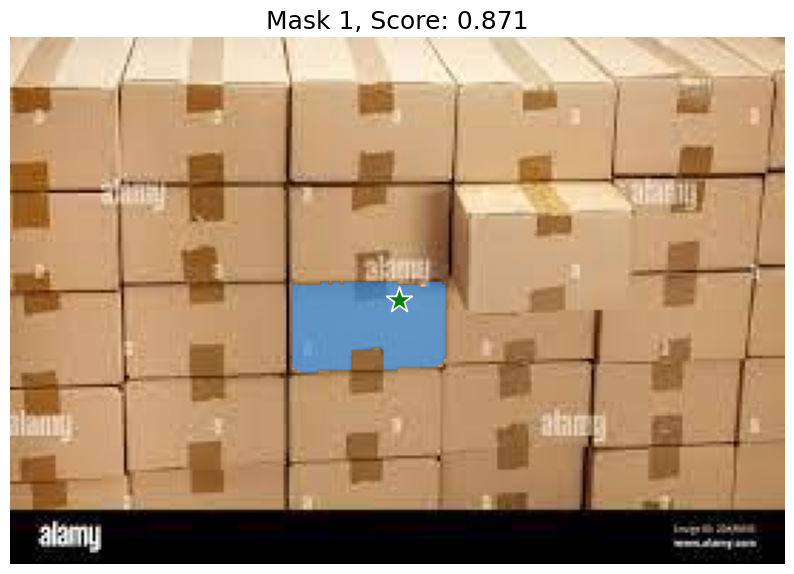

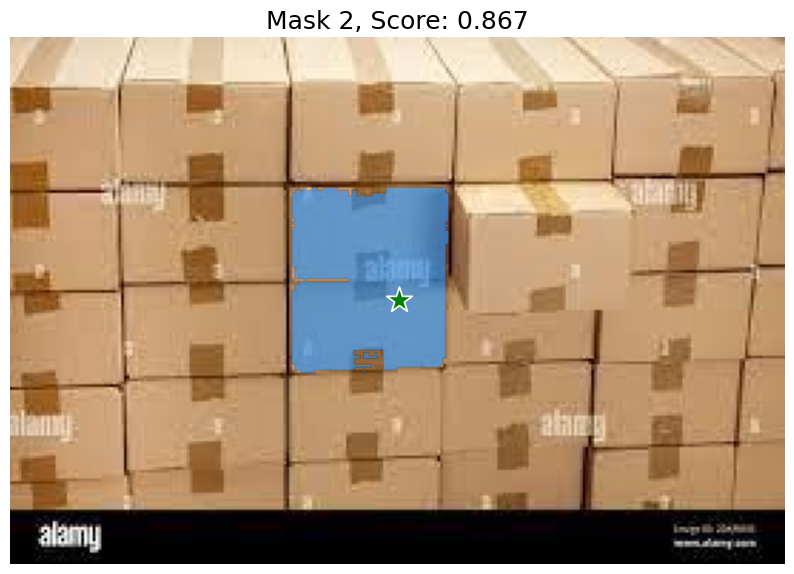

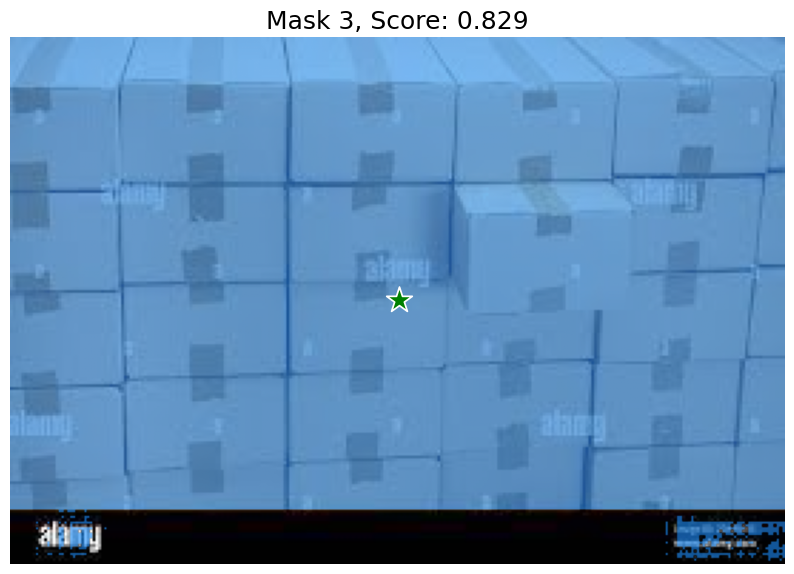

In [38]:
for i, (mask, score) in enumerate(zip(masks, scores)):
    plot_mask_with_score(image, i+1, mask, score, input_point, input_label)


In [39]:
import numpy as np

def get_mask_with_highest_score(masks, scores, logits):
    # Ensure that masks, scores, and logits are numpy arrays
    masks = np.array(masks)
    scores = np.array(scores)
    logits = np.array(logits)

    # Find the index of the mask with the highest score
    max_score_index = np.argmax(scores)

    # Get the mask with the highest score
    mask_with_highest_score = masks[max_score_index]

    # Get the score and logits corresponding to the highest score
    highest_score = scores[max_score_index]
    logits_for_highest_score = logits[max_score_index]

    return mask_with_highest_score, highest_score, logits_for_highest_score


mask_with_highest_score, highest_score, logits_for_highest_score = get_mask_with_highest_score(masks, scores, logits)


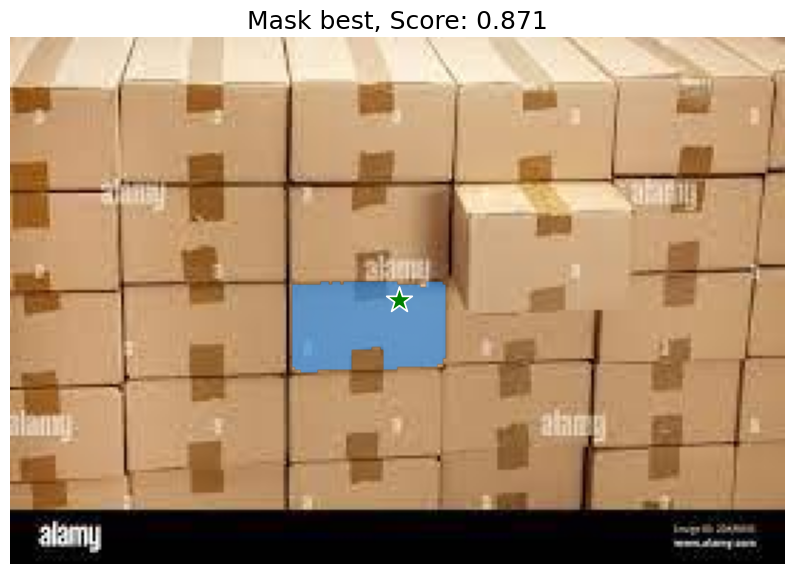

In [40]:
plot_mask_with_score(image, "best", mask_with_highest_score, highest_score, input_point, input_label)


In [41]:
sample_mask = mask_with_highest_score
sample_mask

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [43]:
sample_mask.shape

(185, 272)

In [44]:
image.shape

(185, 272, 3)

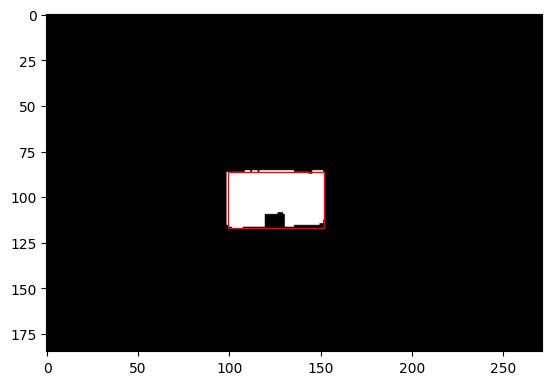

In [45]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def plot_square(mask):
    # Find the indices where the mask is True
    true_indices = np.argwhere(mask)

    # Get the bounding box of the True region
    top_left = np.min(true_indices, axis=0)
    bottom_right = np.max(true_indices, axis=0)

    # Calculate the width and height of the bounding box
    width = bottom_right[1] - top_left[1]
    height = bottom_right[0] - top_left[0]

    # Create a figure and axis
    fig, ax = plt.subplots(1)

    # Plot the mask
    ax.imshow(mask, cmap='gray')

    # Create a rectangle patch
    rect = patches.Rectangle((top_left[1], top_left[0]), width, height, linewidth=1, edgecolor='r', facecolor='none')

    # Add the rectangle patch to the axis
    ax.add_patch(rect)

    # Show the plot
    plt.show()

# Example usage:
# Assuming you have your mask array named "mask"
plot_square(sample_mask)


In [73]:
import numpy as np

def get_bounding_box_coordinates(mask):
    # Find the indices where the mask is True
    true_indices = np.argwhere(mask)

    # Get the bounding box of the True region
    top_left = np.min(true_indices, axis=0)
    bottom_right = np.max(true_indices, axis=0)

    # Calculate the width and height of the bounding box
    width = bottom_right[1] - top_left[1]
    height = bottom_right[0] - top_left[0]

    # Calculate the coordinates of the corners
    top_right = (top_left[1] + width, top_left[0])
    bottom_left = (top_left[1], top_left[0] + height)
    bottom_right = (top_left[1] + width, top_left[0] + height)

    return top_left, top_right, bottom_left, bottom_right

# Example usage:
# Assuming you have your mask array named "mask"
top_left, top_right, bottom_left, bottom_right = get_bounding_box_coordinates(sample_mask)
print("Top left:", top_left)
print("Top right:", top_right)
print("Bottom left:", bottom_left)
print("Bottom right:", bottom_right)


Top left: [86 99]
Top right: (152, 86)
Bottom left: (99, 117)
Bottom right: (152, 117)


In [74]:
import numpy as np

def get_bounding_box_coordinates_updated(mask):
    # Find the indices where the mask is True
    true_indices = np.argwhere(mask)

    # Get the bounding box of the True region
    top_left = np.min(true_indices, axis=0)
    bottom_right = np.max(true_indices, axis=0)

    # Calculate the width and height of the bounding box
    width = bottom_right[1] - top_left[1]
    height = bottom_right[0] - top_left[0]

    # Calculate the coordinates of the corners
    top_right = (top_left[1] + width, top_left[0])
    bottom_left = (top_left[1], top_left[0] + height)
    bottom_right = (top_left[1] + width, top_left[0] + height)

    top_left[0] = top_right[0] - (bottom_right[0]-bottom_left[0])
    top_left[1] = (top_right[1]-bottom_right[1]) + bottom_left[1]

    return top_left, top_right, bottom_left, bottom_right

# Example usage:
# Assuming you have your mask array named "mask"
top_left, top_right, bottom_left, bottom_right = get_bounding_box_coordinates_updated(sample_mask)
print("Top left:", top_left)
print("Top right:", top_right)
print("Bottom left:", bottom_left)
print("Bottom right:", bottom_right)


Top left: [99 86]
Top right: (152, 86)
Bottom left: (99, 117)
Bottom right: (152, 117)


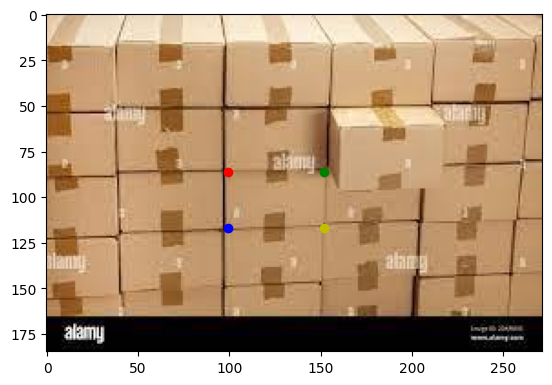

In [92]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def annotate_square_corners(image, top_left, top_right, bottom_left, bottom_right, save_path):
    # Create a figure and axis
    fig, ax = plt.subplots(1)

    # Plot the original image
    ax.imshow(image)

    # Annotate the corners
    ax.plot(top_left[0], top_left[1], 'ro')          # Top Left corner
    ax.plot(top_right[0], top_right[1], 'go')        # Top Right corner
    ax.plot(bottom_left[0], bottom_left[1], 'bo')    # Bottom Left corner
    ax.plot(bottom_right[0], bottom_right[1], 'yo')  # Bottom Right corner

    # Show the plot
    plt.show()

    # Save the plot to the specified path
    plt.savefig(save_path)

    # Close the plot to release resources
    plt.close()

# Example usage:
# Assuming you have your original image as "image" and the corners' coordinates obtained from get_square_corners
top_left, top_right, bottom_left, bottom_right = get_bounding_box_coordinates_updated(sample_mask)
annotate_square_corners(image, top_left, top_right, bottom_left, bottom_right, "/content/sample_image_annotated.jpg")


In [98]:
import matplotlib.pyplot as plt

def annotate_square_corners(image, top_left, top_right, bottom_left, bottom_right, save_path):
    # Create a figure and axis
    fig, ax = plt.subplots(1)

    # Plot the original image
    ax.imshow(image)

    # Annotate the corners
    ax.plot(top_left[0], top_left[1], 'ro')          # Top Left corner
    ax.plot(top_right[0], top_right[1], 'go')        # Top Right corner
    ax.plot(bottom_left[0], bottom_left[1], 'bo')    # Bottom Left corner
    ax.plot(bottom_right[0], bottom_right[1], 'yo')  # Bottom Right corner

    # Save the plot to the specified path
    plt.savefig(save_path)

    # Close the plot to release resources
    plt.close()

# Example usage:
# Assuming you have your image and corner coordinates
top_left, top_right, bottom_left, bottom_right = get_bounding_box_coordinates_updated(sample_mask)
annotate_square_corners(image, top_left, top_right, bottom_left, bottom_right, "/content/sample_image_annotated.jpg")


## Pipeline

In [65]:
def get_box_coordinates(image_path:str,showOriginalImage=False, showPoints=True, showMasksWithScores=True, showPlotMaskWithHighestScore=True):
  # load image
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # plot original image
  if showOriginalImage:
    plot_image(img)

  # get image dimensions
  img_height, img_width, _ = img.shape

  # get centre point coordinates
  center_point_coords = [ int(img_width/2), int(img_height/2)]
  input_point = np.array([center_point_coords])
  input_label = np.array([1])

  if showPoints:
    plt.figure(figsize=(10,10))
    plt.imshow(img)
    show_points(input_point, input_label, plt.gca())
    plt.axis('on')
    plt.show()


  # draw a rectangle that makes the center point of image

  # generate masks in the relevant area
  predictor.set_image(img)

  img_masks, img_masks_scores, img_masks_logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
  )

  if showMasksWithScores:
    for i, (mask, score) in enumerate(zip(img_masks, img_masks_scores)):
        plot_mask_with_score(img, i+1, mask, score, input_point, input_label)


  # get the mask with the highest score
  img_mask_with_highest_score, img_mask_highest_score, img_mask_logits_for_highest_score = get_mask_with_highest_score(img_masks, img_masks_scores, img_masks_logits)

  if showPlotMaskWithHighestScore:
    plot_square(img_mask_with_highest_score)

  # get the rectangular boxes
  img_top_left, img_top_right, img_bottom_left, img_bottom_right = get_bounding_box_coordinates(img_mask_with_highest_score)

  # get the coordinates of the rectangular bounding box
  annotate_square_corners(img, img_top_left, img_top_right, img_bottom_left, img_bottom_right)

In [69]:
time_list = []

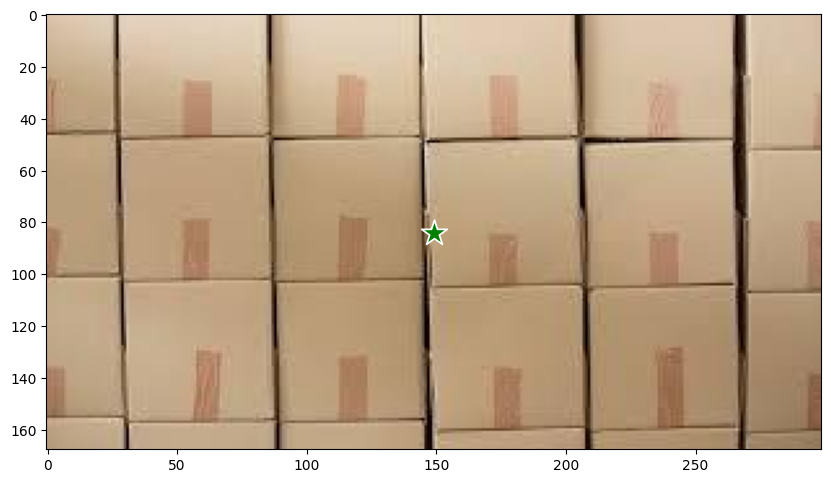

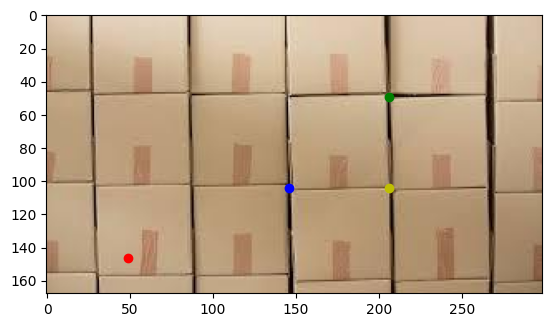

Time taken for operation : 2.479161262512207


In [70]:
import time

start_time = time.time()
get_box_coordinates(image_paths[5],showOriginalImage=False, showPoints=True, showMasksWithScores=False, showPlotMaskWithHighestScore=False)

time_list.append(time.time()-start_time)
print(f"Time taken for operation : {time_list[-1]}")

In [71]:
time_list = []

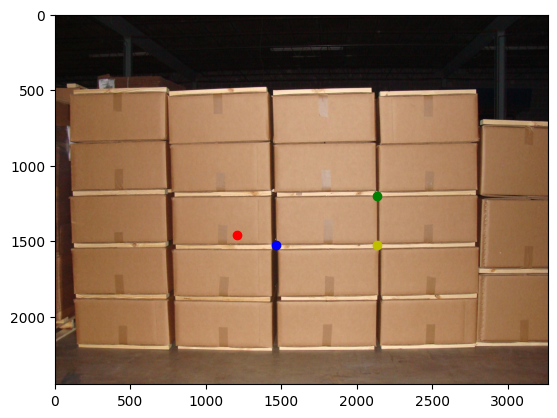

Time taken for operation : 3.8287816047668457


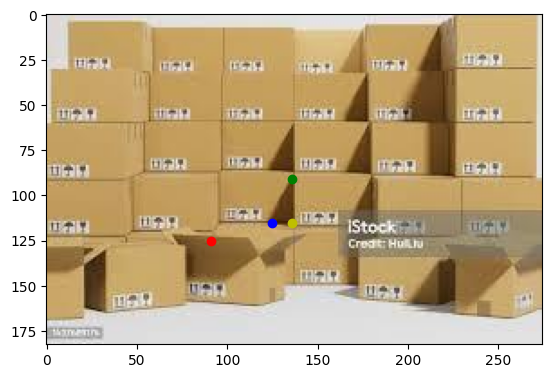

Time taken for operation : 3.1977007389068604


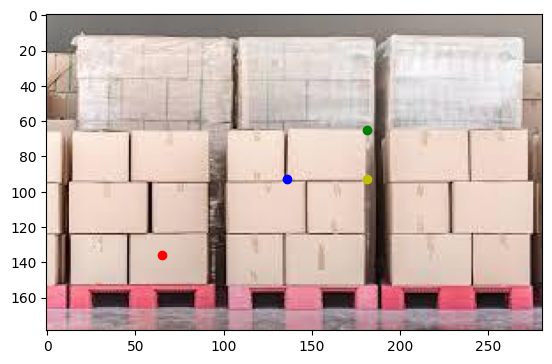

Time taken for operation : 2.0304152965545654


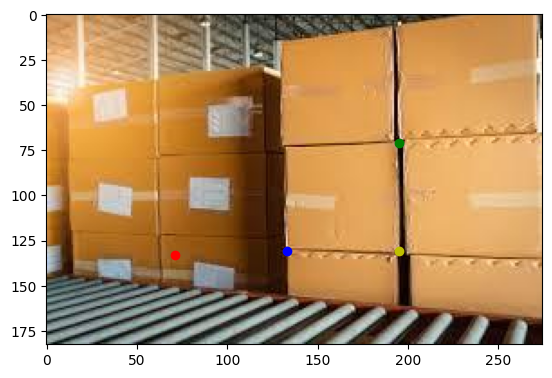

Time taken for operation : 2.0145254135131836


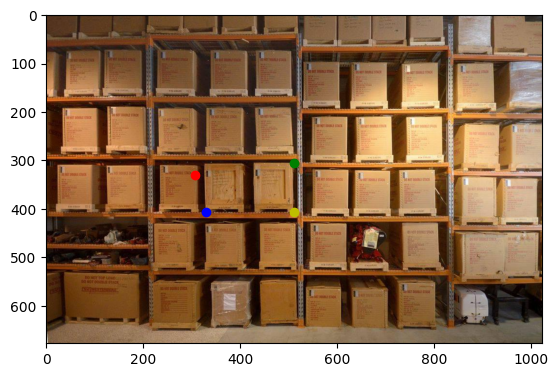

Time taken for operation : 2.1234986782073975


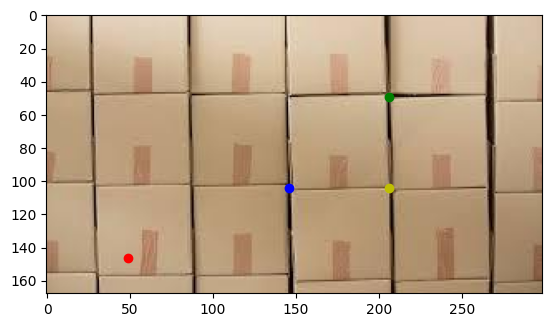

Time taken for operation : 2.6238293647766113


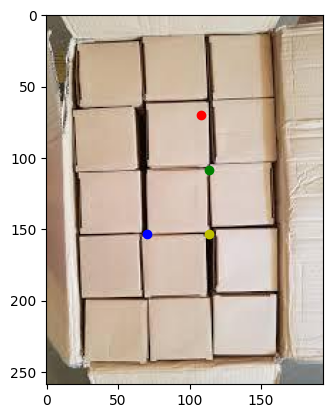

Time taken for operation : 2.081052541732788


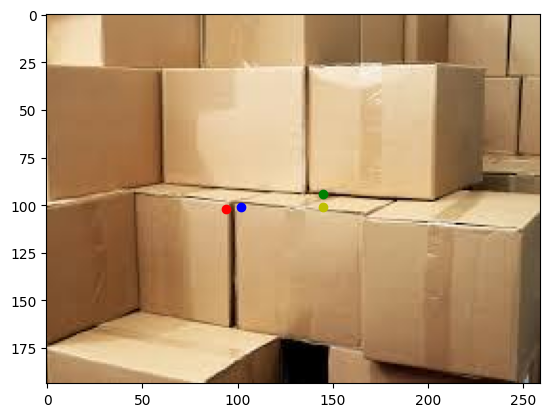

Time taken for operation : 2.3622751235961914


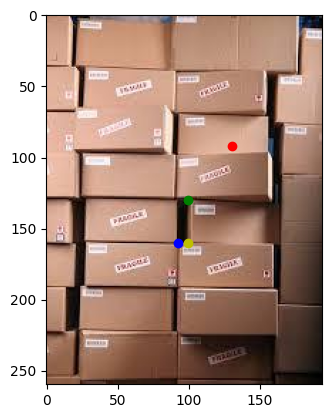

Time taken for operation : 2.028456211090088


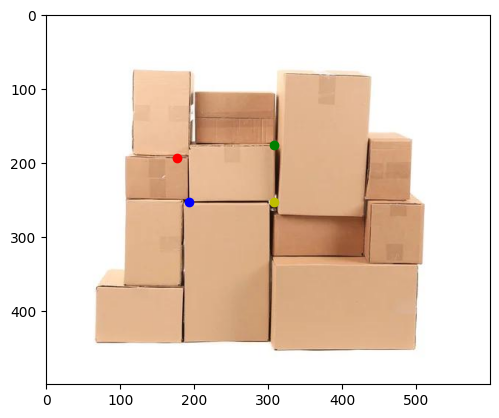

Time taken for operation : 2.5606160163879395


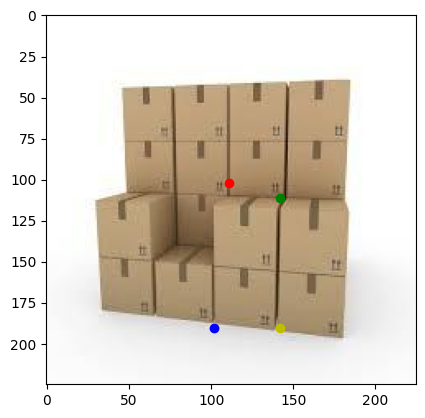

Time taken for operation : 1.9944369792938232


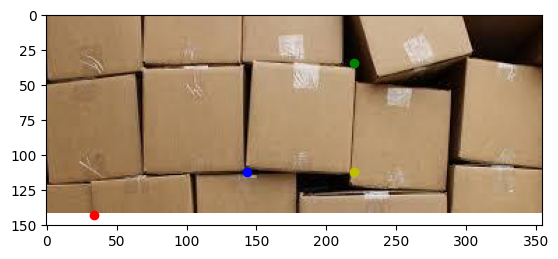

Time taken for operation : 1.983543872833252


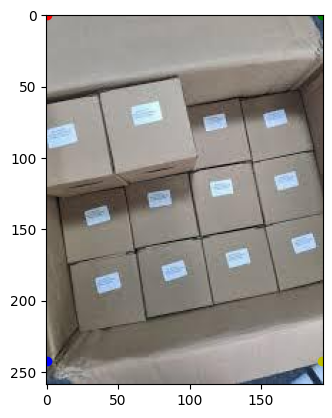

Time taken for operation : 2.0045063495635986


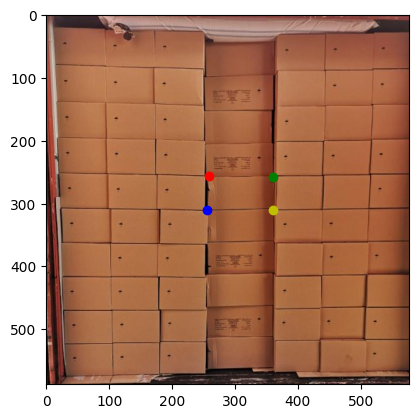

Time taken for operation : 2.4329867362976074


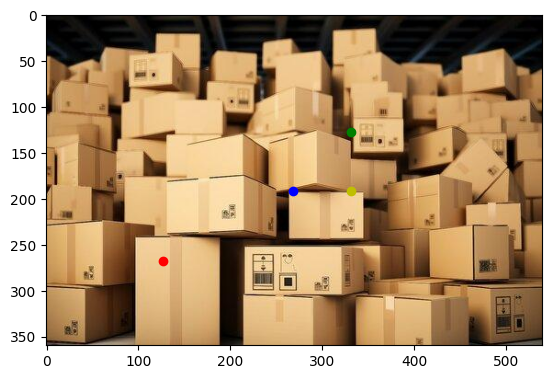

Time taken for operation : 2.094177722930908


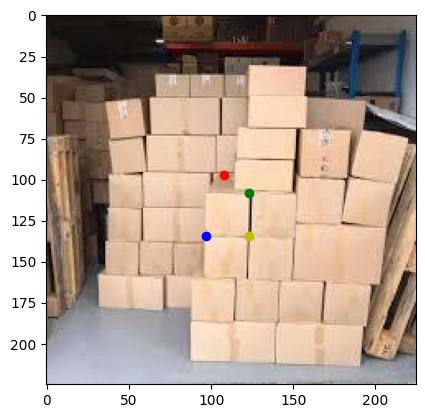

Time taken for operation : 2.044386148452759


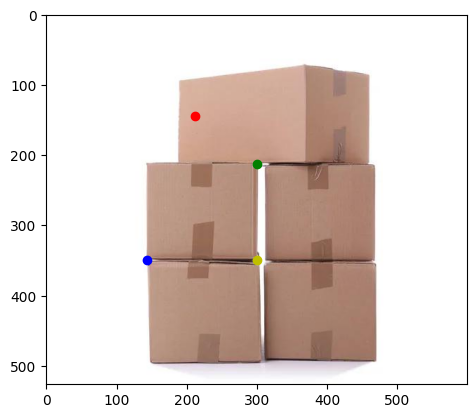

Time taken for operation : 2.418745517730713


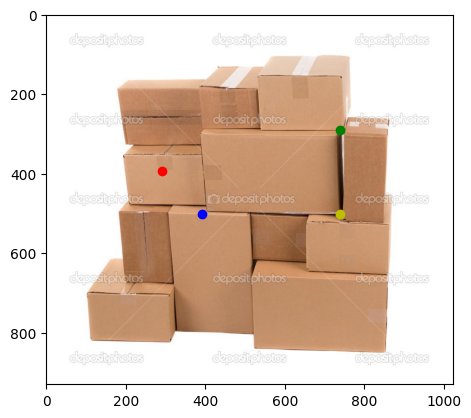

Time taken for operation : 2.1338698863983154


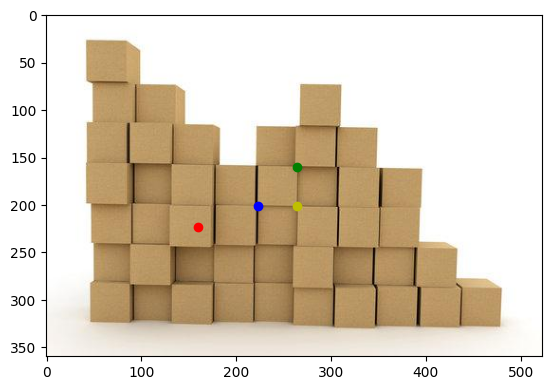

Time taken for operation : 2.9638757705688477


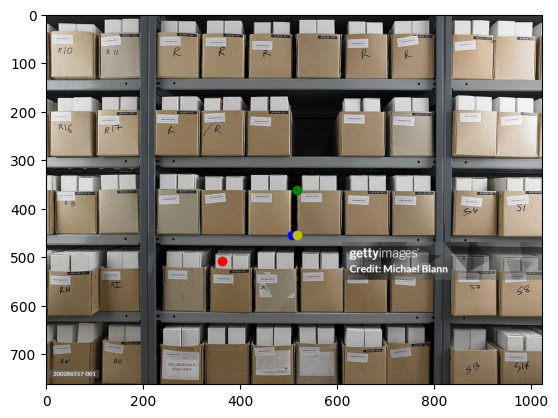

Time taken for operation : 2.9570865631103516


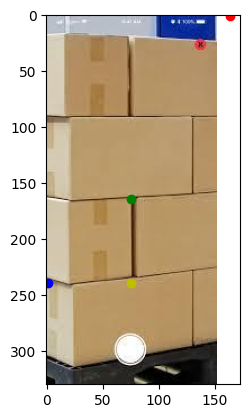

Time taken for operation : 2.0406408309936523


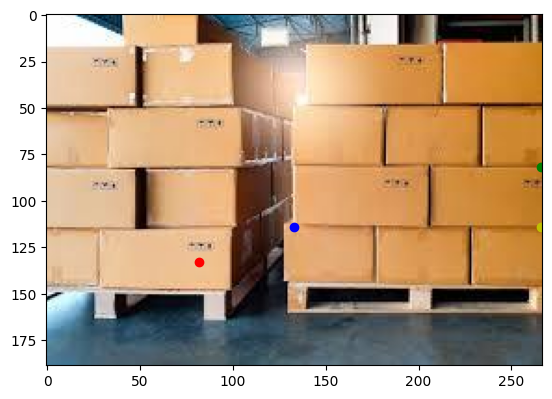

Time taken for operation : 2.085080623626709


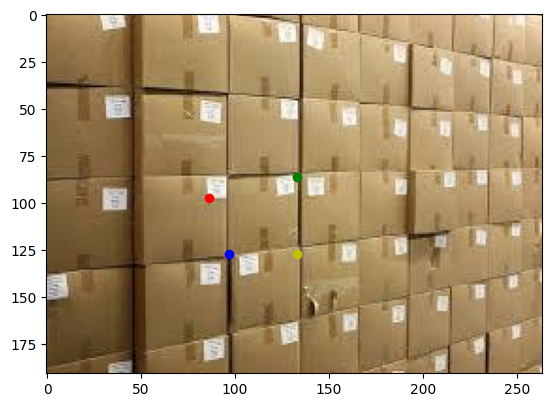

Time taken for operation : 2.1813433170318604


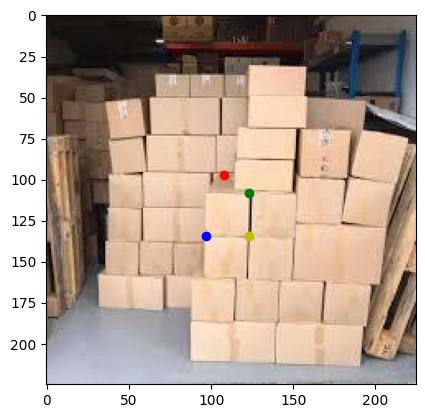

Time taken for operation : 2.2175846099853516


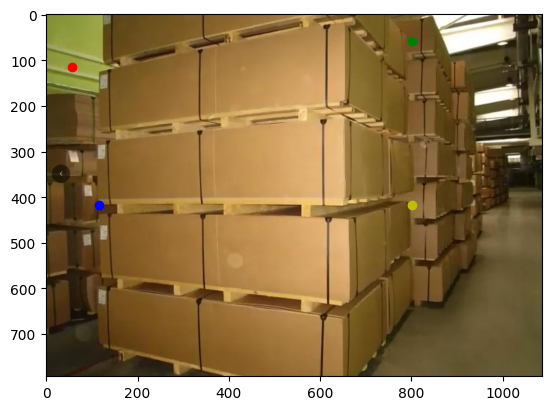

Time taken for operation : 2.4412052631378174


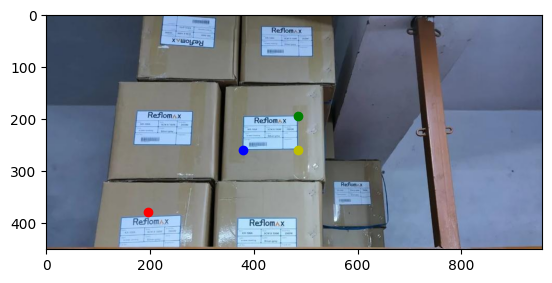

Time taken for operation : 2.1552178859710693


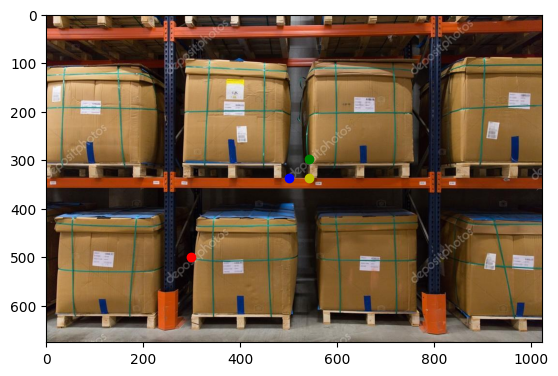

Time taken for operation : 2.8944993019104004


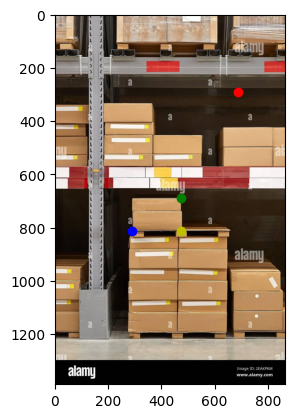

Time taken for operation : 2.2438724040985107


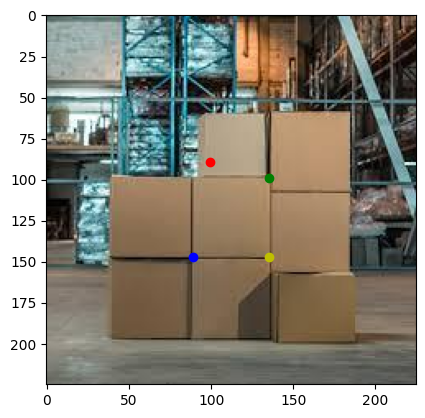

Time taken for operation : 2.854273557662964


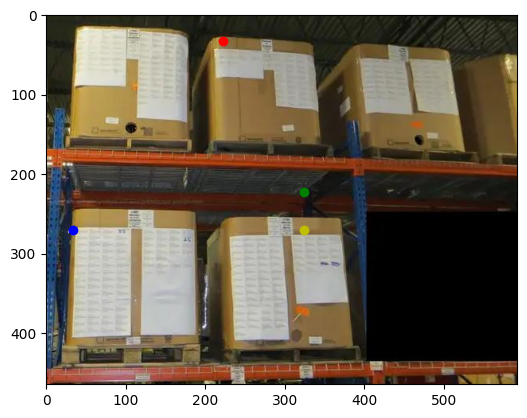

Time taken for operation : 2.9099886417388916


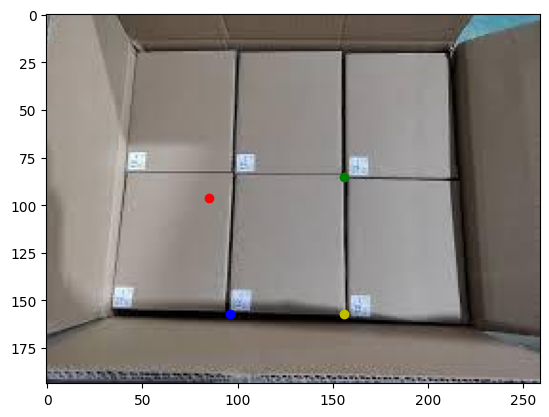

Time taken for operation : 2.0950751304626465


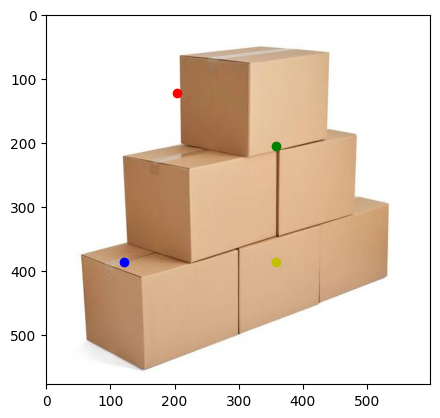

Time taken for operation : 2.0894558429718018


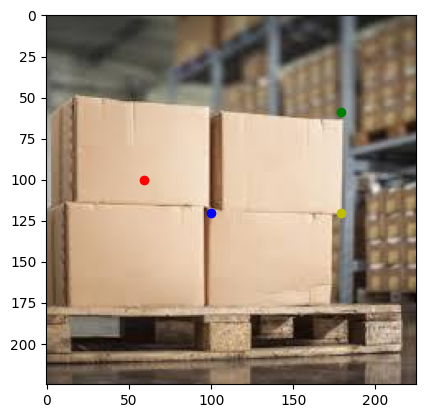

Time taken for operation : 2.8673505783081055


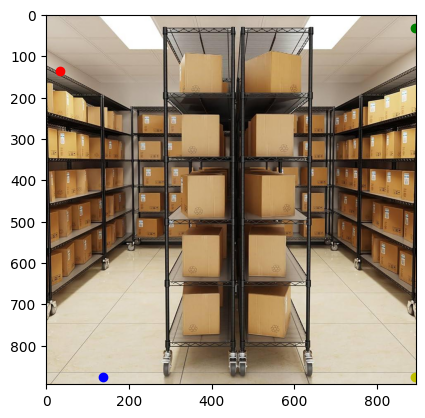

Time taken for operation : 2.229673385620117


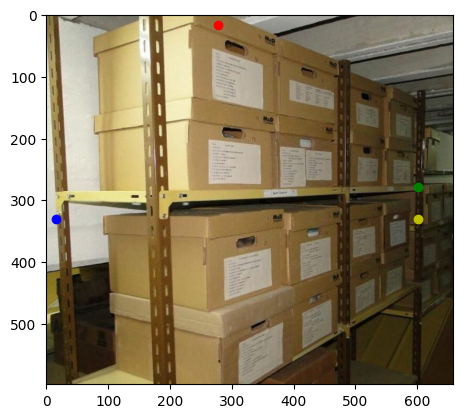

Time taken for operation : 2.1524009704589844


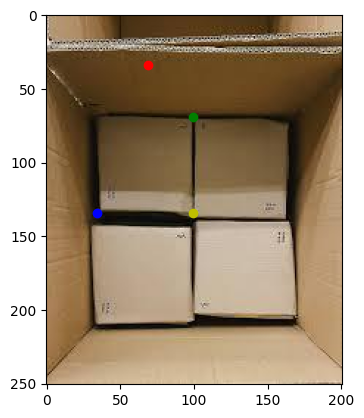

Time taken for operation : 2.037409782409668


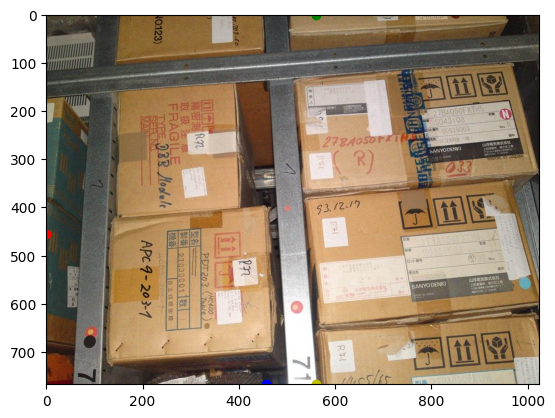

Time taken for operation : 2.462191104888916


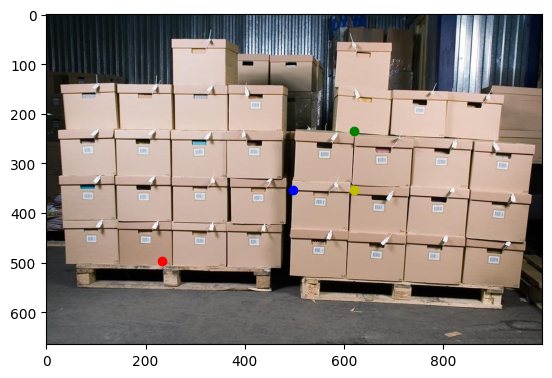

Time taken for operation : 2.1819448471069336


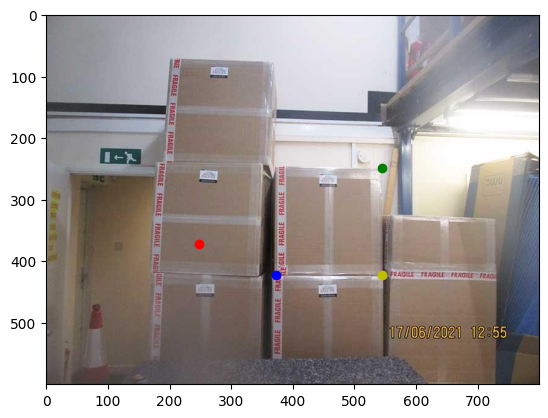

Time taken for operation : 2.3606131076812744


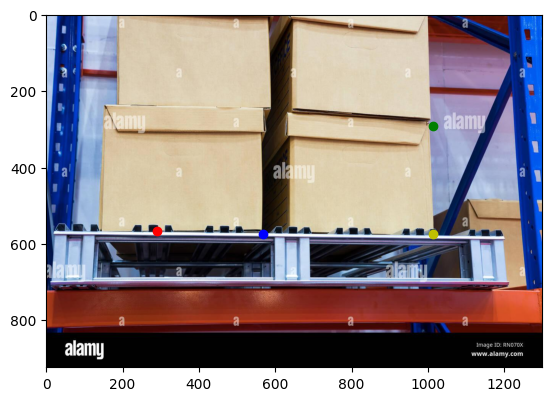

Time taken for operation : 2.2580766677856445


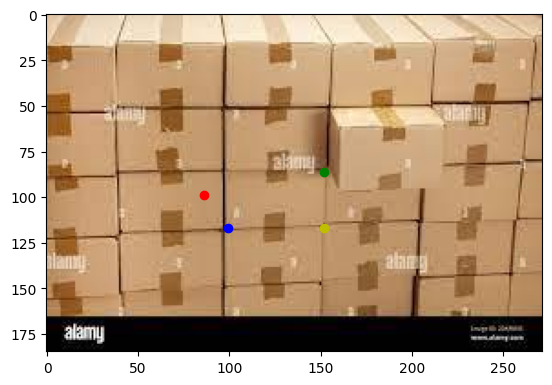

Time taken for operation : 2.222123384475708


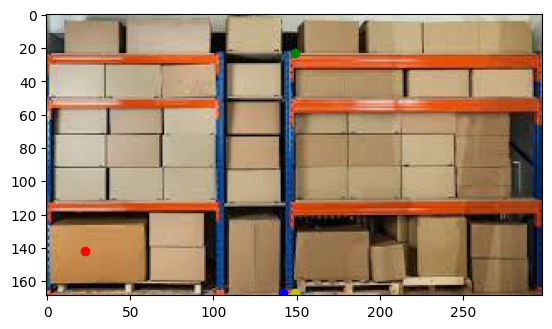

Time taken for operation : 2.071751356124878


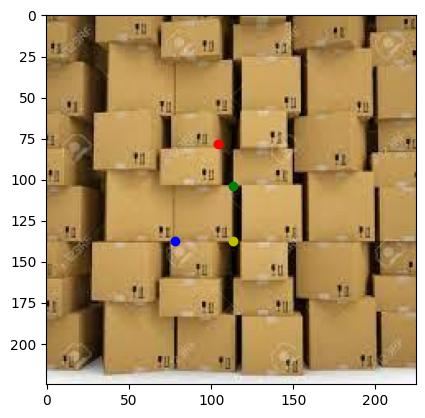

Time taken for operation : 2.1591796875


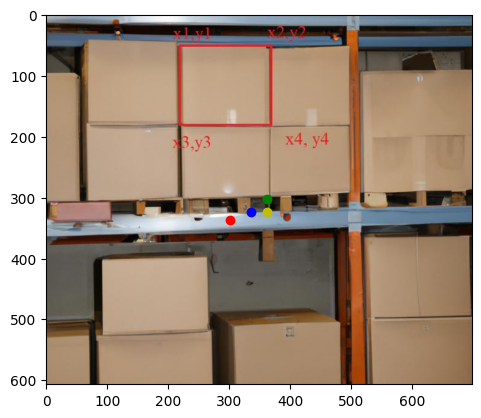

Time taken for operation : 2.242157459259033


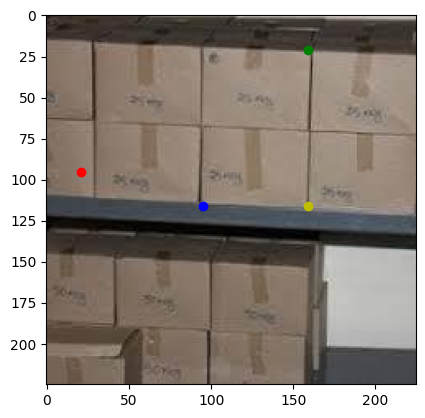

Time taken for operation : 2.1410088539123535


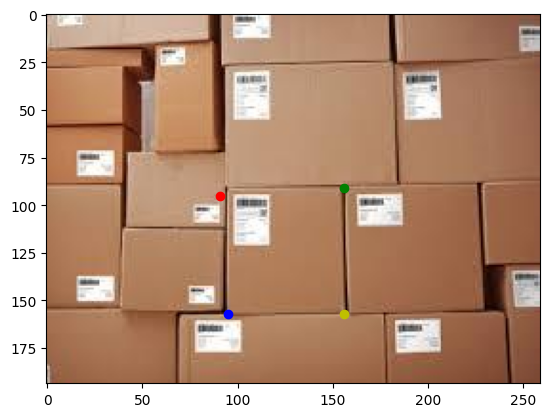

Time taken for operation : 2.0957045555114746


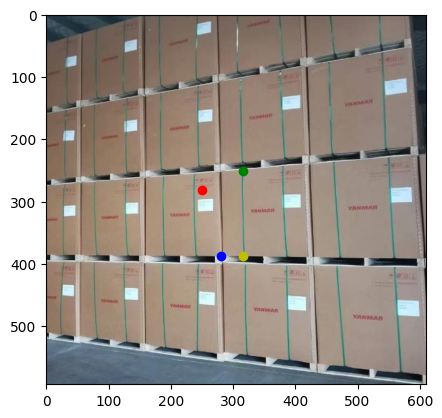

Time taken for operation : 2.13875675201416


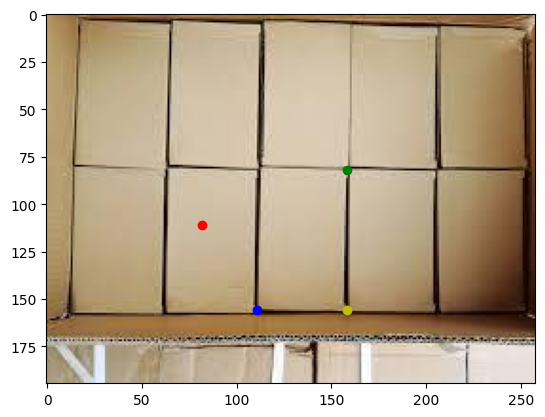

Time taken for operation : 2.1047768592834473


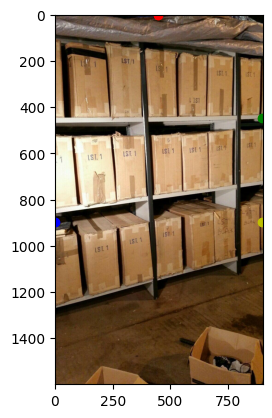

Time taken for operation : 2.330864429473877


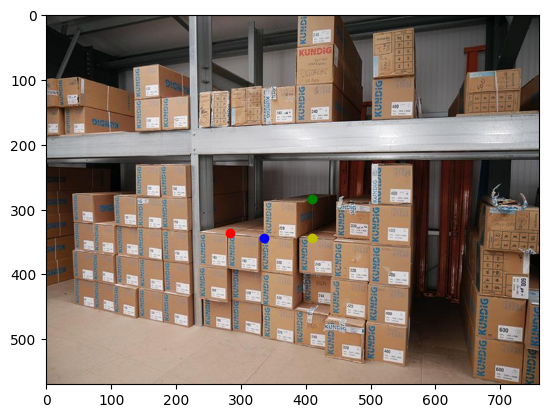

Time taken for operation : 2.7154650688171387


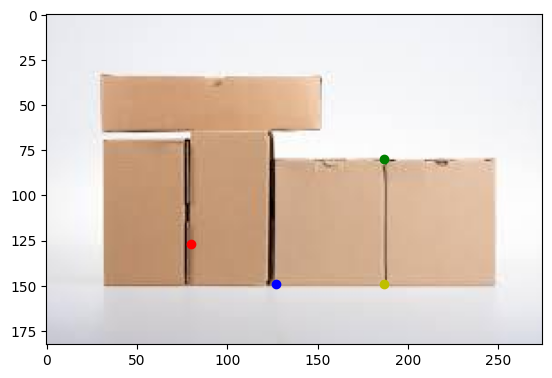

Time taken for operation : 2.108717441558838


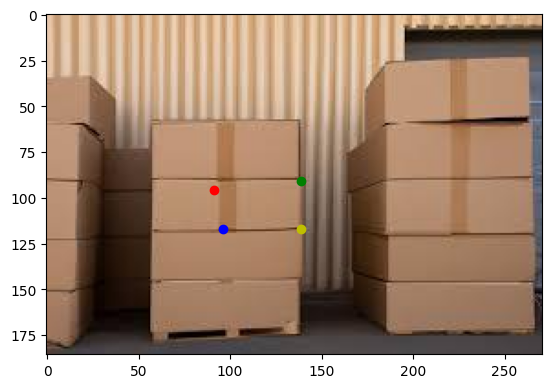

Time taken for operation : 2.870224714279175


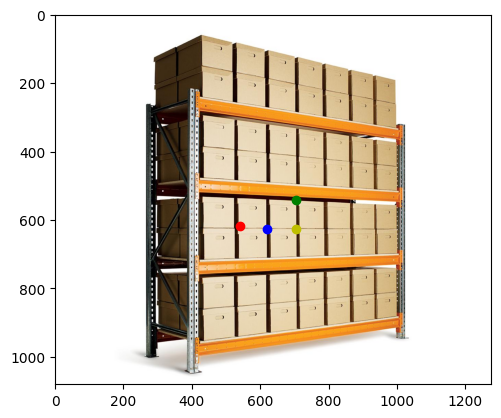

Time taken for operation : 2.274339199066162


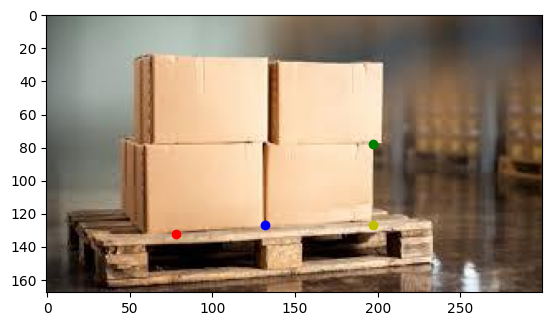

Time taken for operation : 2.1145834922790527


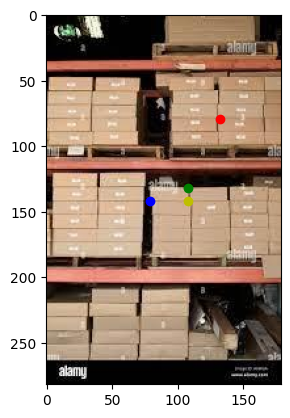

Time taken for operation : 2.183886766433716


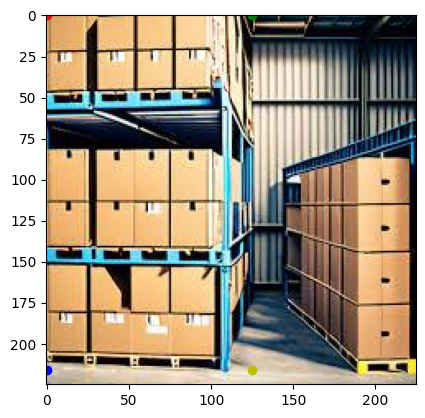

Time taken for operation : 2.4306325912475586


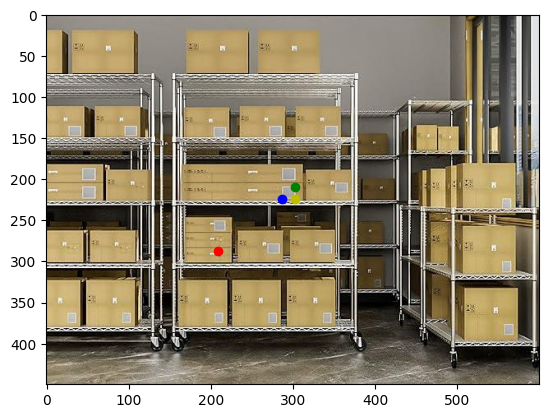

Time taken for operation : 3.0168745517730713


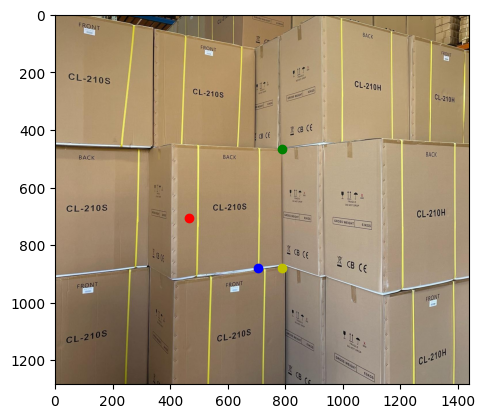

Time taken for operation : 2.3941586017608643


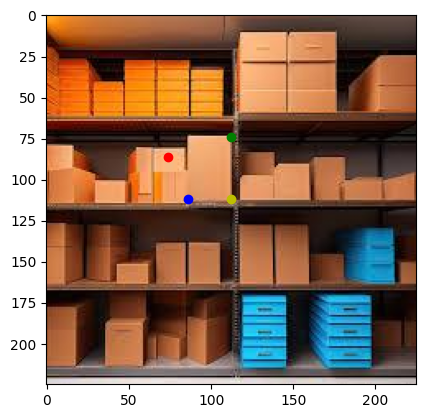

Time taken for operation : 2.1413488388061523


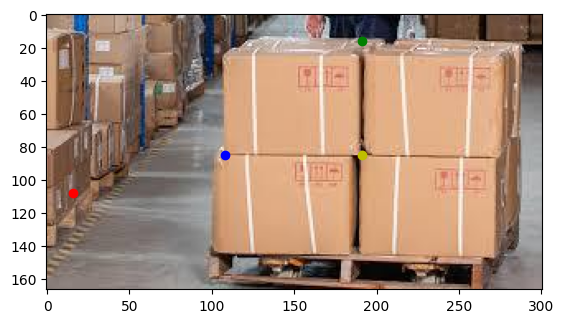

Time taken for operation : 2.2237162590026855


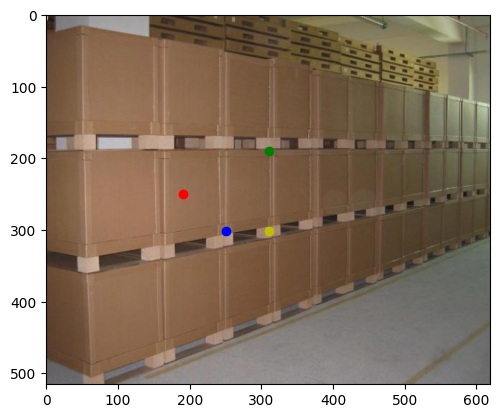

Time taken for operation : 2.1940672397613525


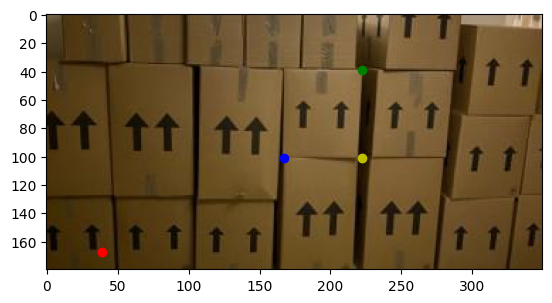

Time taken for operation : 2.111320734024048


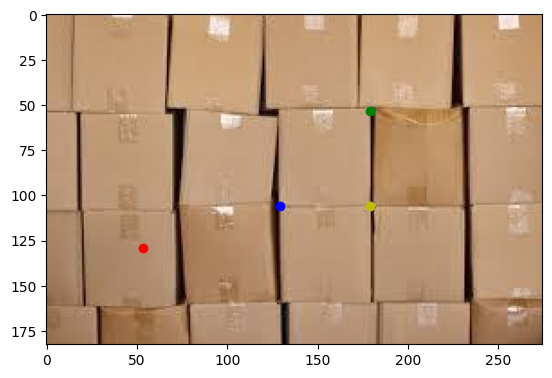

Time taken for operation : 2.908201217651367


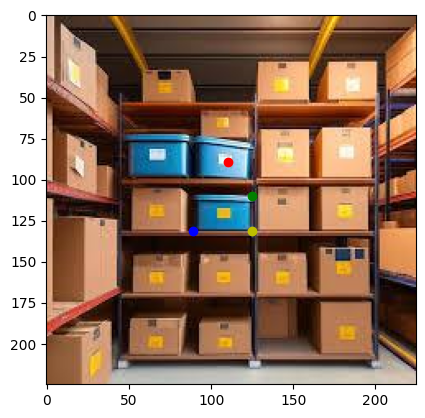

Time taken for operation : 2.3224923610687256


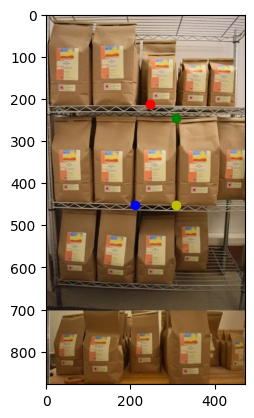

Time taken for operation : 2.693211317062378


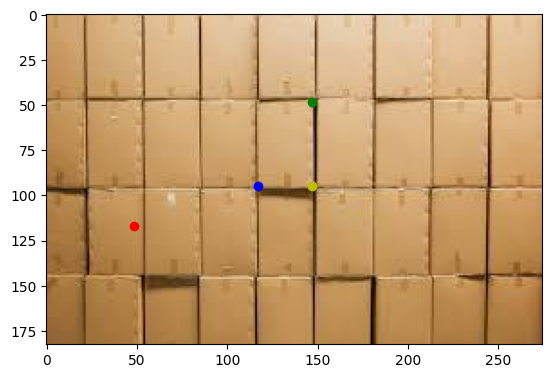

Time taken for operation : 2.1197075843811035


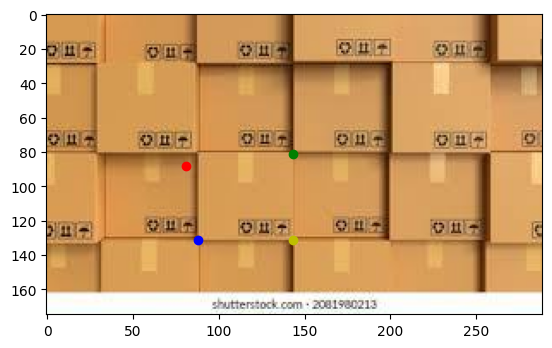

Time taken for operation : 2.1323752403259277


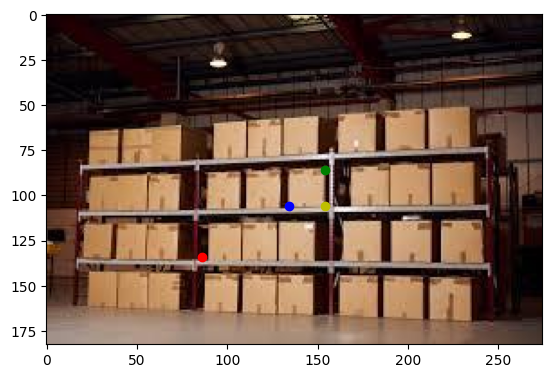

Time taken for operation : 2.712381601333618


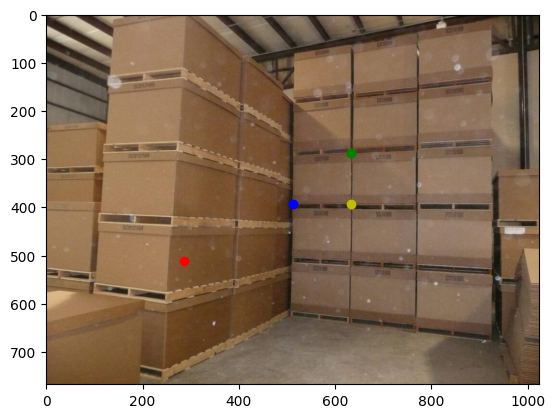

Time taken for operation : 2.363149642944336


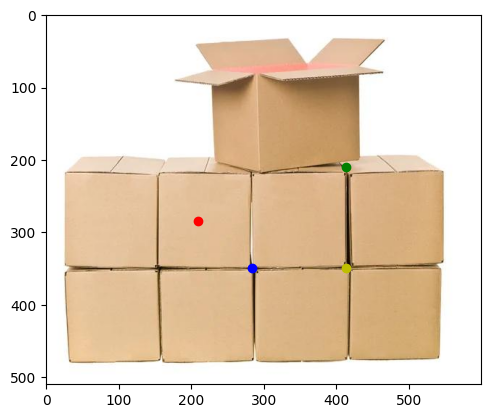

Time taken for operation : 2.1132864952087402


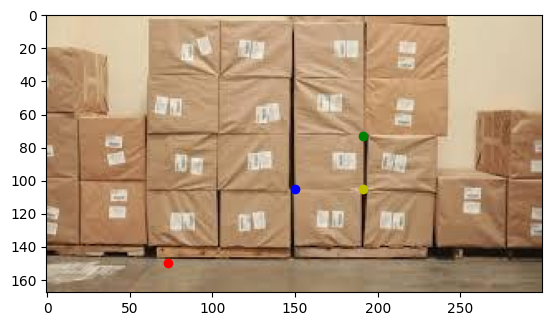

Time taken for operation : 2.293672800064087


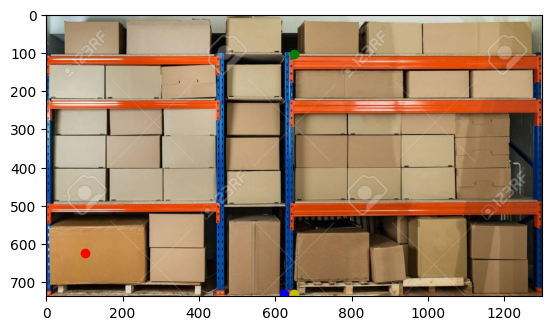

Time taken for operation : 2.3167901039123535


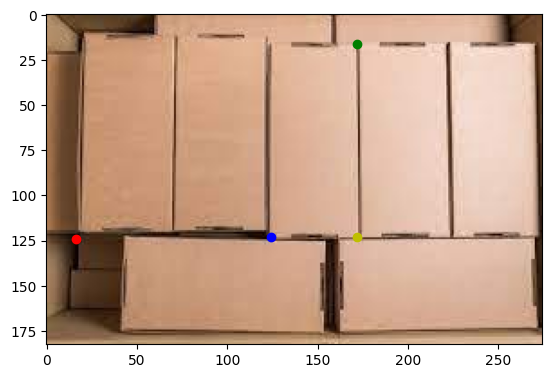

Time taken for operation : 2.110694169998169


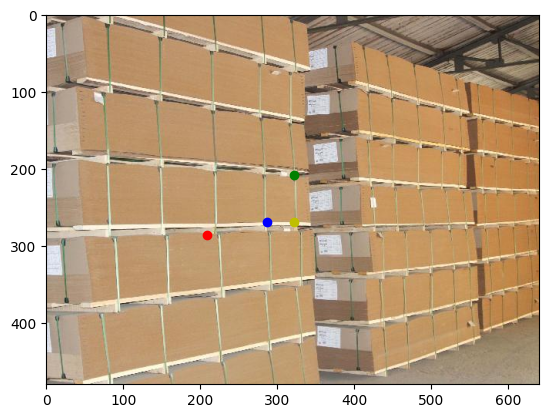

Time taken for operation : 2.239975690841675


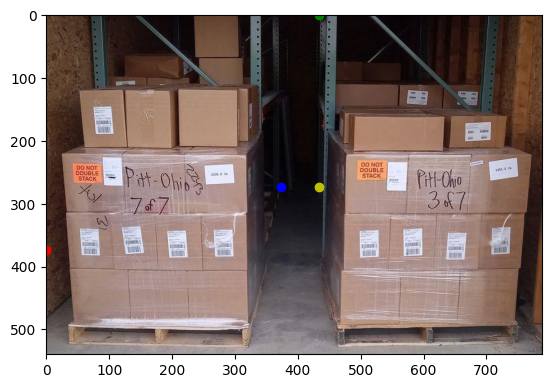

Time taken for operation : 2.2149360179901123


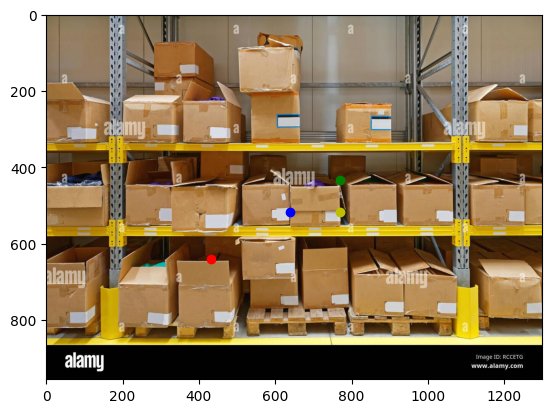

Time taken for operation : 2.6746697425842285


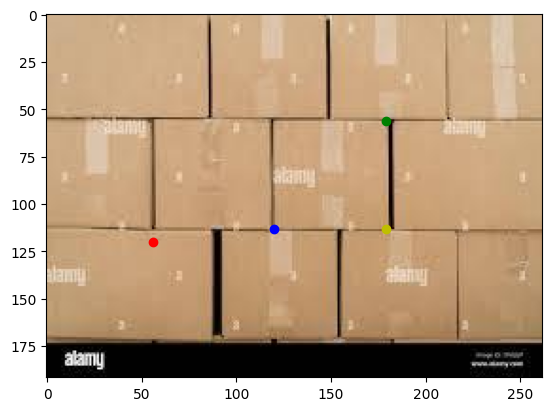

Time taken for operation : 2.144829511642456


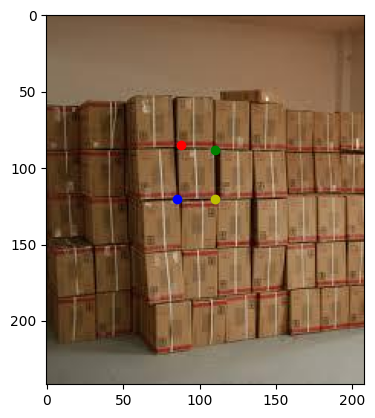

Time taken for operation : 2.1294517517089844


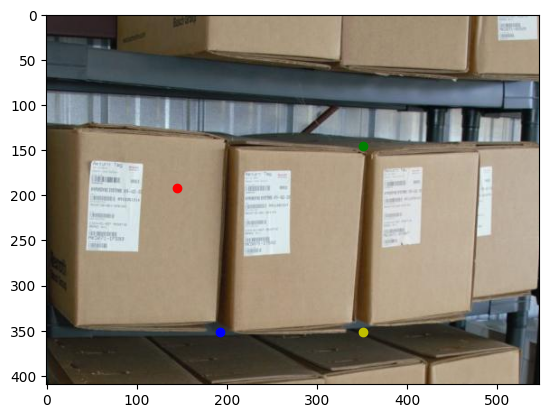

Time taken for operation : 2.184722423553467


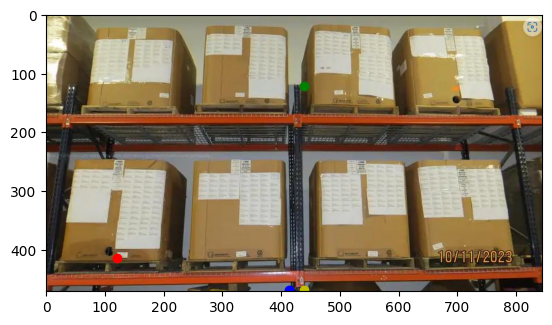

Time taken for operation : 2.25419282913208


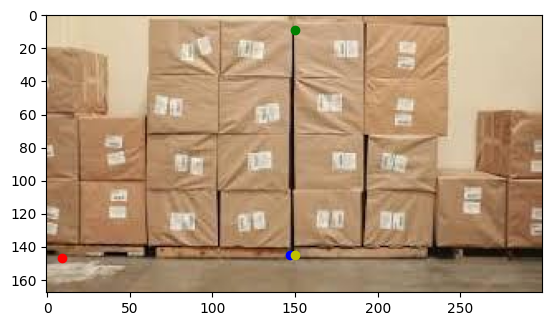

Time taken for operation : 2.1588945388793945


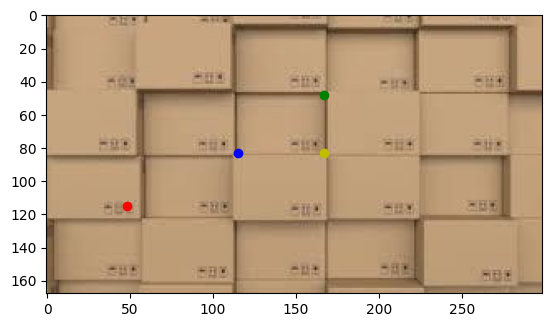

Time taken for operation : 2.9450795650482178


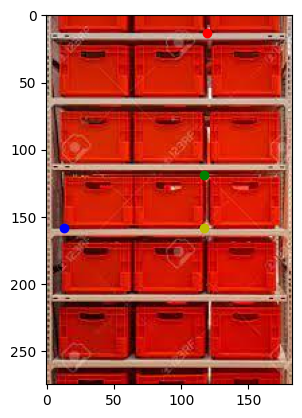

Time taken for operation : 2.942215919494629


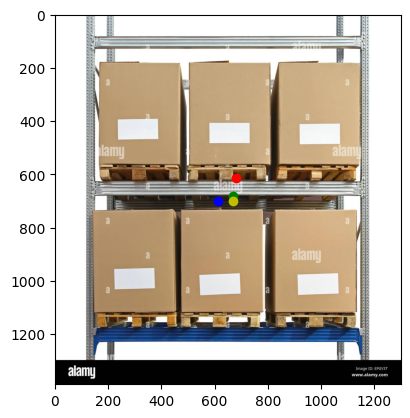

Time taken for operation : 2.7737410068511963


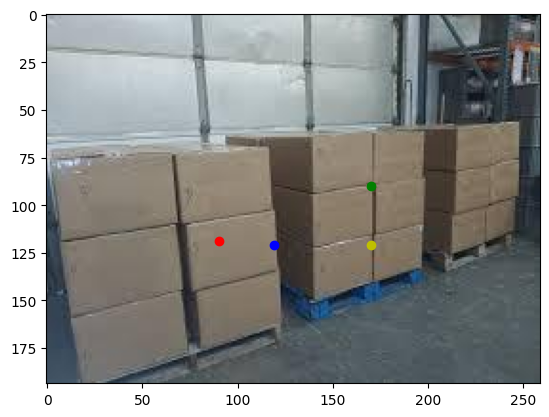

Time taken for operation : 3.161062479019165


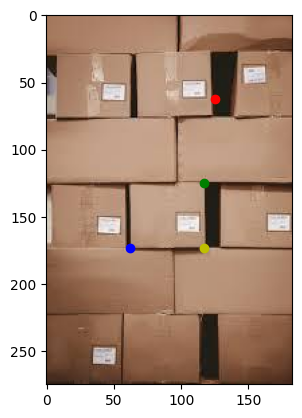

Time taken for operation : 3.161611795425415


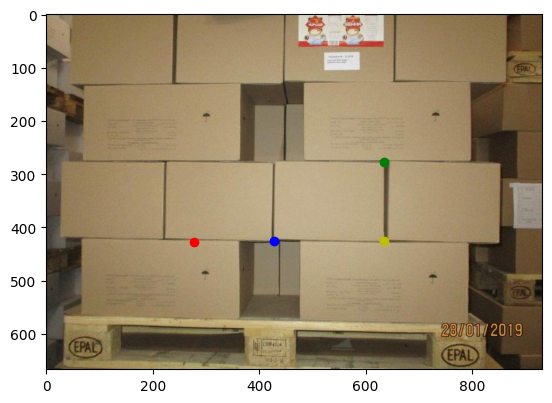

Time taken for operation : 2.7455966472625732


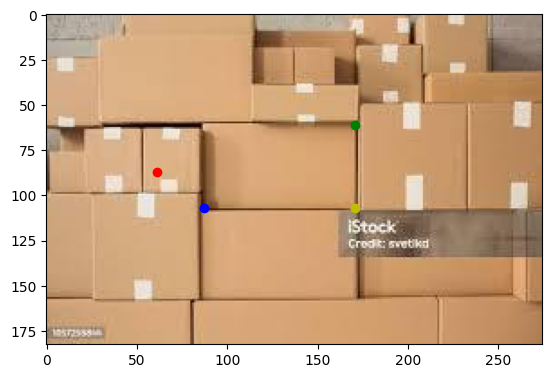

Time taken for operation : 2.5913095474243164


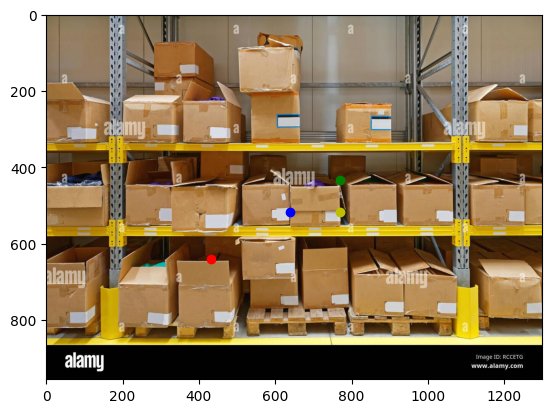

Time taken for operation : 3.529210329055786


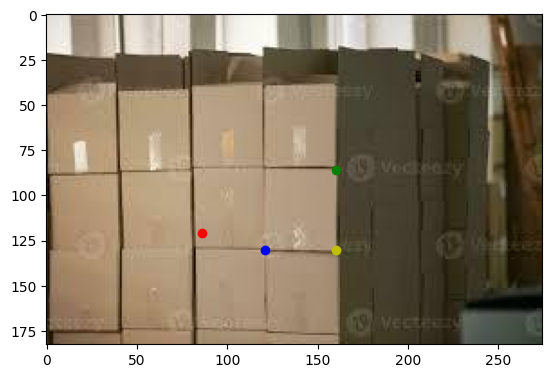

Time taken for operation : 2.9973785877227783


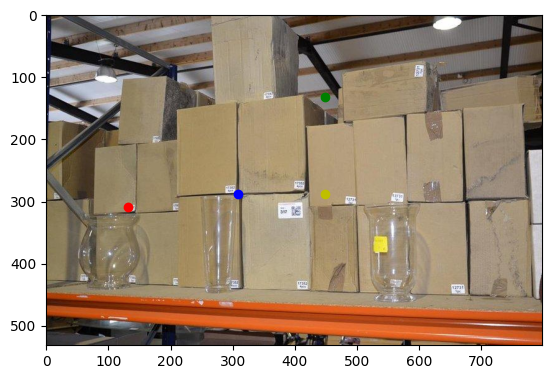

Time taken for operation : 2.9330875873565674


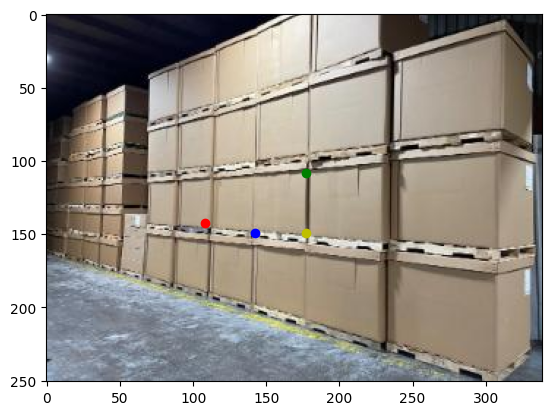

Time taken for operation : 3.0415873527526855


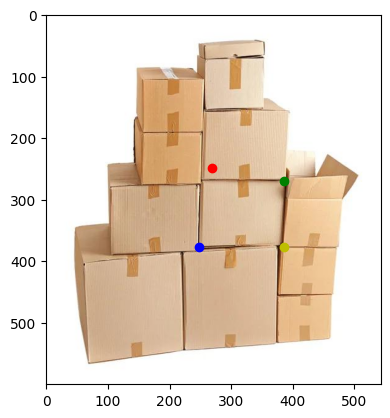

Time taken for operation : 3.0395524501800537


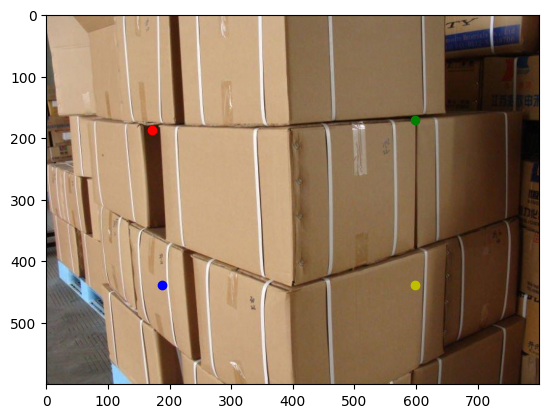

Time taken for operation : 2.9212303161621094


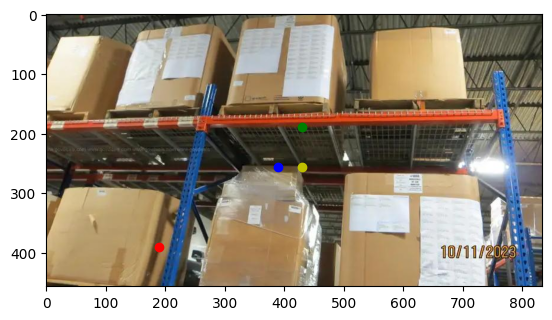

Time taken for operation : 3.1094017028808594


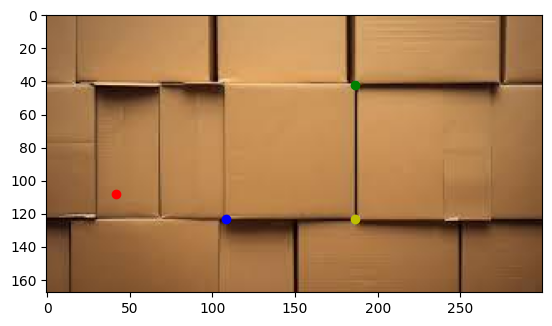

Time taken for operation : 2.8765246868133545


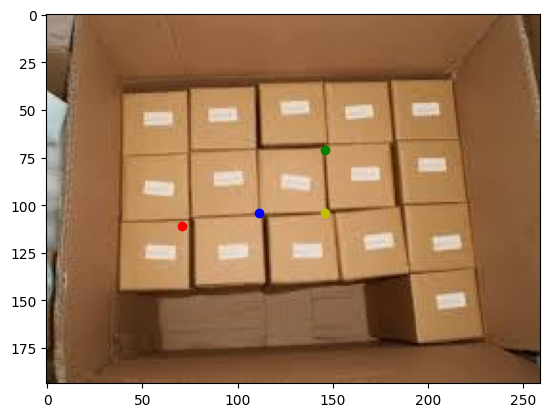

Time taken for operation : 2.1562325954437256


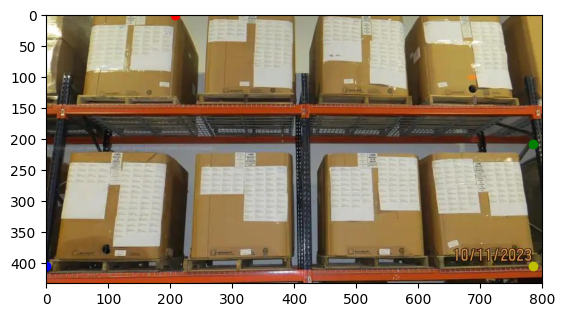

Time taken for operation : 2.8527748584747314


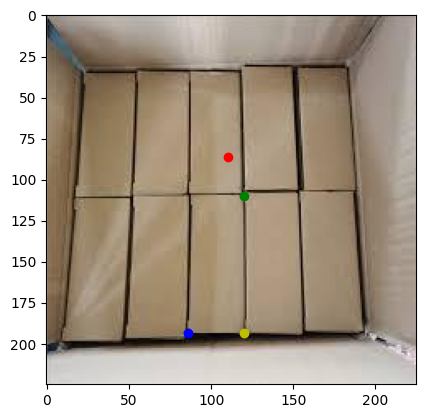

Time taken for operation : 2.3690059185028076


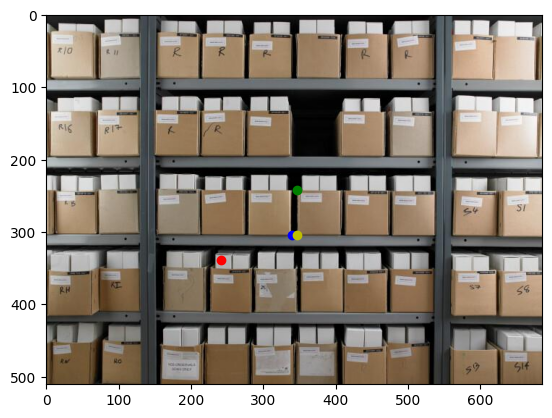

Time taken for operation : 2.699045419692993


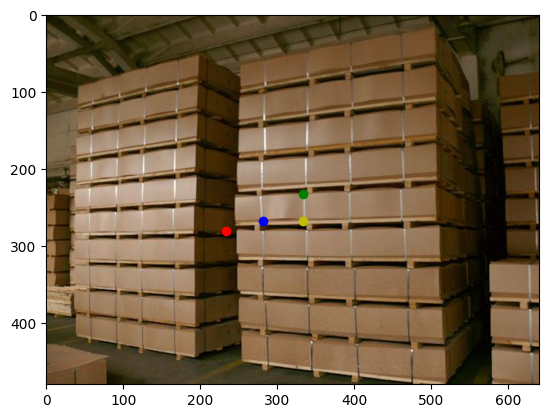

Time taken for operation : 2.9411540031433105


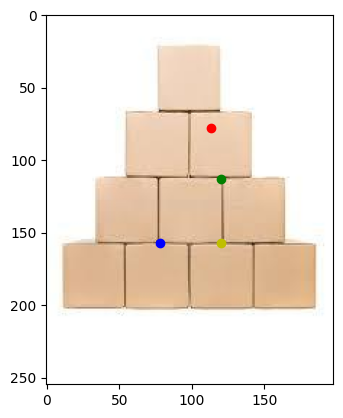

Time taken for operation : 2.08681058883667


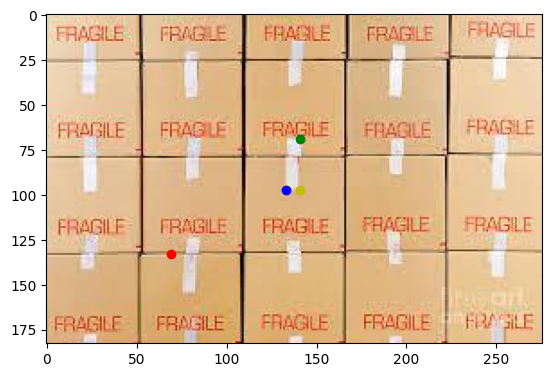

Time taken for operation : 2.1615288257598877


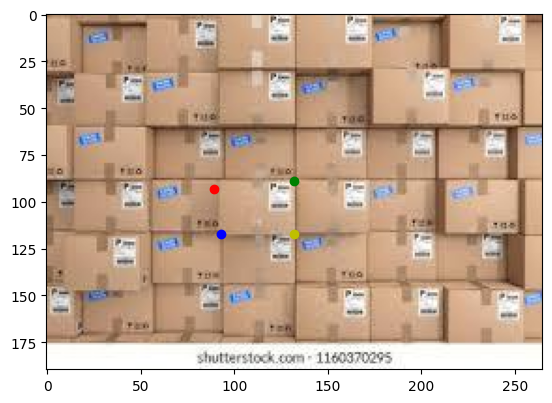

Time taken for operation : 2.194911479949951


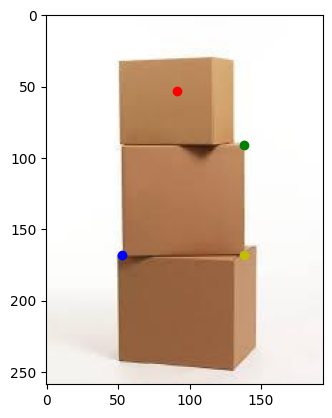

Time taken for operation : 2.604919195175171


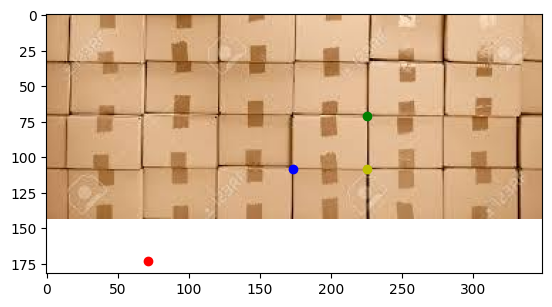

Time taken for operation : 2.116006851196289


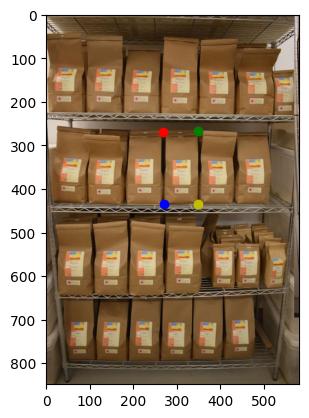

Time taken for operation : 2.2298896312713623


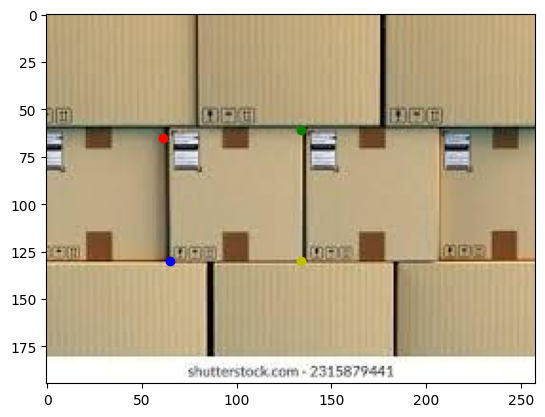

Time taken for operation : 2.1697885990142822


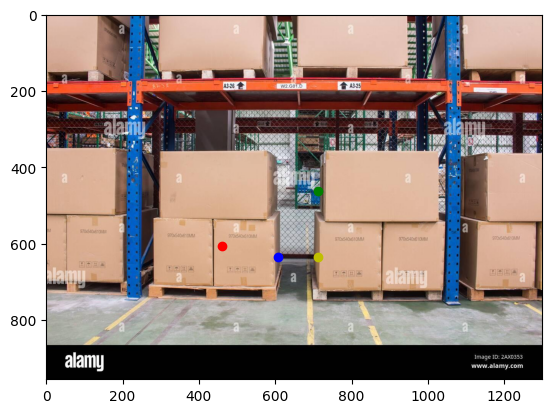

Time taken for operation : 2.4310333728790283


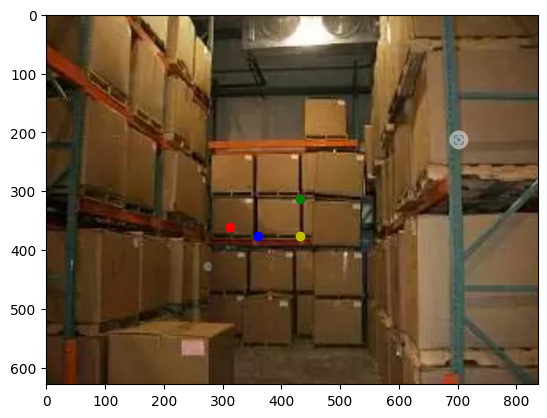

Time taken for operation : 3.0015904903411865


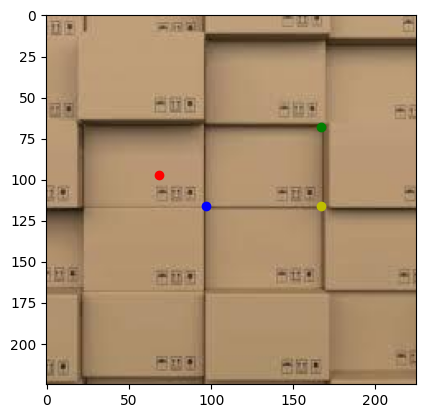

Time taken for operation : 2.1947455406188965


In [72]:
for img_path in image_paths:
  start_time = time.time()
  get_box_coordinates(img_path,showOriginalImage=False, showPoints=False, showMasksWithScores=False, showPlotMaskWithHighestScore=False)

  time_list.append(time.time()-start_time)
  print(f"Time taken for operation : {time_list[-1]}")


In [80]:
avg_time = sum(time_list)/len(image_paths)
print("Average time for inference :", avg_time, " s")

Average time for inference : 2.4323241946933507  s


## Solution for getting an error for top left corner coordinates

In [84]:
# prompt: mount google drive

from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [87]:
output_images_path = "/content/drive/MyDrive/annotated_boxes/"

In [89]:
try:
  os.makedirs(output_images_path)
except FileExistsError:
  print("folder already exists")

folder already exists


In [99]:
def get_box_coordinates_updated(image_path:str,showOriginalImage=False, showPoints=True, showMasksWithScores=True, showPlotMaskWithHighestScore=True):
  img_name = image_path.split("/")[-1]
  # load image
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # plot original image
  if showOriginalImage:
    plot_image(img)

  # get image dimensions
  img_height, img_width, _ = img.shape

  # get centre point coordinates
  center_point_coords = [ int(img_width/2), int(img_height/2)]
  input_point = np.array([center_point_coords])
  input_label = np.array([1])

  if showPoints:
    plt.figure(figsize=(10,10))
    plt.imshow(img)
    show_points(input_point, input_label, plt.gca())
    plt.axis('on')
    plt.show()


  # draw a rectangle that makes the center point of image

  # generate masks in the relevant area
  predictor.set_image(img)

  img_masks, img_masks_scores, img_masks_logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
  )

  if showMasksWithScores:
    for i, (mask, score) in enumerate(zip(img_masks, img_masks_scores)):
        plot_mask_with_score(img, i+1, mask, score, input_point, input_label)


  # get the mask with the highest score
  img_mask_with_highest_score, img_mask_highest_score, img_mask_logits_for_highest_score = get_mask_with_highest_score(img_masks, img_masks_scores, img_masks_logits)

  if showPlotMaskWithHighestScore:
    plot_square(img_mask_with_highest_score)

  # get the rectangular boxes
  img_top_left, img_top_right, img_bottom_left, img_bottom_right = get_bounding_box_coordinates_updated(img_mask_with_highest_score)

  # get the coordinates of the rectangular bounding box

  annotate_square_corners(img, img_top_left, img_top_right, img_bottom_left, img_bottom_right, output_images_path+img_name)

In [100]:
get_box_coordinates_updated(image_paths[0],showOriginalImage=False, showPoints=False, showMasksWithScores=False, showPlotMaskWithHighestScore=False)


In [82]:
updated_time_list = []

In [101]:
for img_path in image_paths:
  # start_time = time.time()
  get_box_coordinates_updated(img_path,showOriginalImage=False, showPoints=False, showMasksWithScores=False, showPlotMaskWithHighestScore=False)

  # updated_time_list.append(time.time()-start_time)
  # print(f"Time taken for operation : {time_list[-1]}")


In [ ]:
updated_avg_time = sum(updated_time_list)/len(image_paths)
print("Average time for inference :", updated_avg_time, " s")